<a href="https://colab.research.google.com/github/tsubame-misa/benzaiten/blob/main/benzaiten_starter_magenta.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AIミュージックバトル！『弁財天』Starter Kit ver. 1.0（Magenta版）
2022年12月25日版

[@ml_taro](https://twitter.com/ml_taro)　
[@johannyjm1](https://twitter.com/johannyjm1)　
[@y__mattu](https://twitter.com/y__mattu)

## このノートブックは何か
　このノートブックでは、AIミュージックバトル！『弁財天』に出場したい人が、対戦ルールに準拠したメロディ生成プログラムを作るための、参考となるプログラムを提供します。

　このノートブックでは、 Google の OSS である Magenta を活用し[スターターキット Tensorflow 版](https://docs.google.com/document/d/1CizJ6b9i2yZ9OIDPrBWUROyJahlZrlqe-naxh4brACQ/edit?usp=sharing) を拡張を試みます。
今回はMagentaと呼ばれるOSSで公開されている事前学習済みモデルをダウンロードし、自ら学習させる作業無しでもそこそこの品質でメロディーが作れてしまうという解法を紹介します。

　基本的な仕様（フォルダの構成や入出力の制約など）は スターターキット Tensorflow 版と共通のため予めご確認ください。

　共有されたプログラムは、そのまま Google Colaboratory 上で実行してみる（メロディが付与されたMIDIファイルが生成され、聴くことができる）ことができます。GPUの利用が前提になりますので、上部メニューバーから「ランタイム」>「ランタイムのタイプを変更」と遷移し、「ハードウェア アクセラレータ」が「GPU」になっていることを確認しておきましょう。


# 本文書が提供するプログラムのライセンス
　本文書に掲載したプログラムは、MITライセンスにて提供します。著作権は放棄しませんが、MITライセンスの条項を厳守する限り、自由に使っていただいて構いません。
MITランセンスの本文は https://opensource.org/licenses/mit-license.php　、その参考日本語訳は https://licenses.opensource.jp/MIT/MIT.html をご覧ください。copyright holder は「増田　太郎 (Taro Masuda)」、yearは「2022」とします。

In [ ]:
# 必要なライブラリのインストール
!pip install mido==1.2.6 > /dev/null
!pip install midi2audio==0.1.1 > /dev/null
!apt install fluidsynth > /dev/null
!pip install pretty_midi==0.2.9 > /dev/null
!pip install Pillow==9.0.0 -U -q
# !pip install magenta==2.1.4 > /dev/null
# !pip install magenta==2.1.3 > /dev/null
# !pip install music21==5.5.0 -U -q



     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 55.6 MB/s eta 0:00:00


In [ ]:
!pip install magenta==2.1.4 > /dev/null
# !pip install magenta==2.1.3 > /dev/null
!pip install music21==5.5.0 -U -q

In [ ]:
# このセルを実行した後、数秒間お待ちください

import IPython
IPython.Application.instance().kernel.do_shutdown(restart=True)

{'status': 'ok', 'restart': True}

In [ ]:
# Googleドライブをマウント
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import music21
import numpy as np
import matplotlib.pyplot as plt
import mido
import csv
import IPython.display as ipd
import midi2audio
import glob



'''
各種定数、パスの設定
''' 
TOTAL_MEASURES = 240        # 学習用MusicXMLを読み込む際の小節数の上限
UNIT_MEASURES = 4           # 1回の生成で扱う旋律の長さ
BEAT_RESO = 4               # 1拍を何個に分割するか（4の場合は16分音符単位）
N_BEATS = 4                 # 1小節の拍数（今回は4/4なので常に4）
NOTENUM_FROM = 36           # 扱う音域の下限（この値を含む）
NOTENUM_THRU = 84           # 扱う音域の上限（この値を含まない）
INTRO_BLANK_MEASURES = 4    # ブランクおよび伴奏の小節数の合計
MELODY_LENGTH = 8           # 生成するメロディの長さ（小節数）
 
KEY_ROOT = "C"              # 生成するメロディの調のルート（"C" or "A"）
KEY_MODE = "major"          # 生成するメロディの調のモード（"major" or "minor"）

basedir = "/content/drive/MyDrive/弁財天/magenta/" # 作業フォルダ

## Magenta版サンプルプログラムの仕様
- MagentaはGoogleが開発したAI音楽系のOSSです。
- 今回はその中でも「improv RNN」呼ばれるモデルを使用し、コード進行の系列を入力、RNNが推論した即興のメロディー（単音）を出力とする実装例を紹介します。
- 今回のコード内では、モデルは公開されている学習済みの物をダウンロードして使用しますが、データセットさえあれば好きな物でファンチューニングすることも可能です（詳しくは公式のリポジトリなどをご参照ください）。

In [ ]:
# 作業ディレクトリの作成と学習済モデルのダウンロード
# !mkdir $basedir"/input/"
# !mkdir $basedir"/output/"
%cd /content/drive/MyDrive/弁財天/magenta/input/
!wget -q http://download.magenta.tensorflow.org/models/chord_pitches_improv.mag
%cd ..

/content/drive/MyDrive/弁財天/magenta/input
/content/drive/MyDrive/弁財天/magenta


In [ ]:
# 指定された仕様のcsvファイルを読み込んで
# ChordSymbol列を返す
def read_chord_file(file):
  chord_seq = [None] * (MELODY_LENGTH * N_BEATS)
  with open(file) as f:
    reader = csv.reader(f)
    for row in reader:
      m = int(row[0]) # 小節番号（0始まり）
      if m < MELODY_LENGTH:
        b = int(row[1]) # 拍番号（0始まり、今回は0または2）
        chord_seq[m*4+b] = music21.harmony.ChordSymbol(root=row[2], 
                                                       kind=row[3], 
                                                       bass=row[4])
  for i in range(len(chord_seq)):
    if chord_seq[i] != None:
      chord = chord_seq[i]
    else:
      chord_seq[i] = chord
  return chord_seq

In [ ]:
# コード進行からChordSymbol列を生成
# divisionは1小節に何個コードを入れるか
def make_chord_seq(chord_prog, division):
  T = int(N_BEATS * BEAT_RESO / division)
  seq = [None] * (T * len(chord_prog))
  for i in range(len(chord_prog)):
    for t in range(T):
      if isinstance(chord_prog[i], music21.harmony.ChordSymbol):
        seq[i * T + t] = chord_prog[i]
      else:
        seq[i * T + t] = music21.harmony.ChordSymbol(chord_prog[i])
  return seq

In [ ]:
# ChordSymbol列をmany-hot (chroma) vector列に変換
def chord_seq_to_chroma(chord_seq):
  N = len(chord_seq)
  matrix = np.zeros((N, 12))
  for i in range(N):
    if chord_seq[i] != None:
      for note in chord_seq[i]._notes:
        matrix[i, note.pitch.midi % 12] = 1
  return matrix

In [ ]:
# 空（全要素がゼロ）のピアノロールを生成
def make_empty_pianoroll(length):
  return np.zeros((length, NOTENUM_THRU - NOTENUM_FROM + 1))


In [ ]:
# ピアノロールを描画し、MIDIファイルを再生
def show_and_play_midi(pianoroll, transpose, src_filename, dst_filename):
  # ピアノロール（one-hot vector列）をノートナンバー列に変換
  def calc_notenums_from_pianoroll(pianoroll):
    notenums = []
    for i in range(pianoroll.shape[0]):
      n = np.argmax(pianoroll[i, :])
      nn = -1 if n == pianoroll.shape[1] - 1 else n + NOTENUM_FROM
      notenums.append(nn)
    return notenums

  # 連続するノートナンバーを統合して (notenums, durations) に変換
  def calc_durations(notenums):
    N = len(notenums)
    duration = [1] * N
    for i in range(N):
      k = 1
      while i + k < N:
        if notenums[i] > 0 and notenums[i] == notenums[i + k]:
          notenums[i + k] = 0
          duration[i] += 1
        else:
          break
        k += 1
    return notenums, duration

  # MIDIファイルを生成
  def make_midi(notenums, durations, transpose, src_filename, dst_filename):
    midi = mido.MidiFile(src_filename)
    MIDI_DIVISION = midi.ticks_per_beat
    track = mido.MidiTrack()
    midi.tracks.append(track)
    init_tick = INTRO_BLANK_MEASURES * N_BEATS * MIDI_DIVISION
    prev_tick = 0
    for i in range(len(notenums)):
      if notenums[i] > 0:
        curr_tick = int(i * MIDI_DIVISION / BEAT_RESO) + init_tick
        track.append(mido.Message('note_on', note=notenums[i]+transpose, 
                                  velocity=100, time=curr_tick - prev_tick))
        prev_tick = curr_tick
        curr_tick = int((i + durations[i]) * MIDI_DIVISION / BEAT_RESO) + init_tick
        track.append(mido.Message('note_off', note=notenums[i]+transpose, 
                                  velocity=100, time=curr_tick - prev_tick))
        prev_tick = curr_tick
    midi.save(dst_filename)

  plt.matshow(np.transpose(pianoroll))
  plt.show()
  notenums = calc_notenums_from_pianoroll(pianoroll)
  notenums, durations = calc_durations(notenums)
  make_midi(notenums, durations, transpose, src_filename, dst_filename)
  fs = midi2audio.FluidSynth(sound_font="/usr/share/sounds/sf2/FluidR3_GM.sf2")
  fs.midi_to_audio(dst_filename, "output.wav")
  ipd.display(ipd.Audio("output.wav"))

In [ ]:
# ピアノロールを描画
def show_pianoroll(pianoroll):
  plt.matshow(np.transpose(pianoroll))
  plt.show()

In [ ]:
import pretty_midi # TODO: midoで代替できそうだったら代替する

backing_file = "sample1_backing.mid"       # 適宜変更すること
chord_file = "sample1_chord.csv"           # 適宜変更すること
output_file = "でこぼこふれんず1.mid"                # 自分のエントリーネームに変更すること
 
chord_prog = read_chord_file(basedir + chord_file)
chroma_vec = chord_seq_to_chroma(make_chord_seq(chord_prog, N_BEATS))
pianoroll = make_empty_pianoroll(chroma_vec.shape[0])



In [ ]:
from collections import OrderedDict
# magenta向けにコード進行列のstringを加工
# TODO: chord記法の変換パターンの網羅
dict_modify_chords = OrderedDict({
    'seventh': '7',
    'major': 'M',
    'minor': 'm',
    '-': ''
})

def parse_chord_for_magenta(filepath:str) -> str:
  chords_str = '"'
  with open(filepath, 'r') as f:
    chords_all = f.readlines()
  for i,chords_cur in enumerate(chords_all):
    chords_cur_list = chords_cur.split(',')[0:4]
    if int(chords_cur_list[0]) >= MELODY_LENGTH: break # 8小節を超えたらループを抜ける
    if chords_cur_list[1] != '0': continue # 小節頭のコード進行のみ採用（その他は捨象する）
    for elem in dict_modify_chords:
      chords_cur_list[3] = chords_cur_list[3].replace(elem, dict_modify_chords[elem])
    chords_str += chords_cur_list[2] + chords_cur_list[3] + ' '
  chords_str += '"'
  return chords_str

chord_prog_magenta = parse_chord_for_magenta(basedir + chord_file)
print(chord_prog_magenta)

"FM7 FM7 Em7 Em7 Dm7 Em7 FM7 FM "


In [ ]:
!ls /content/drive/MyDrive/弁財天/magenta/input/chord_pitches_improv.mag

/content/drive/MyDrive/弁財天/magenta/input/chord_pitches_improv.mag


In [ ]:
!ls /content/drive/MyDrive/弁財天/magenta/

'benzaiten_starter_magenta.ipynb のコピー'   sample2_backing.mid
 input					     sample2_chord.csv
 output					     sample3_backing.mid
 output.wav				     sample3_chord.csv
 sample1_backing.mid			     でこぼこふれんず2.mid
 sample1_chord.csv			     でこぼこふれんず.mid


In [ ]:
#モデルの初期値となる音をランダムで決める
import random

def random_major_note():
  p =  random.random()
  if p < 0.3:
    return "60"
  elif p < 0.6:
    nearest_pitch = "64"
  else:
    return "67"

def random_minor_note():
  p =  random.random()
  if p < 0.3:
    return "57"
  elif p < 0.6:
    nearest_pitch = "60"
  else:
    return "64"



In [ ]:
'''
magentaのimprov_rnnの推論を実行
  --config: 手法の指定（詳細はMagentaドキュメントをご確認ください）
  --bundle_file: 学習済モデルファイルの指定
  --output_dir: 出力ディレクトリの指定
  --num_outputs: 出力メロディーファイルを何個生成するか指定
  --primer_melody: メロディーの出だしのピッチ番号を指定（60は"C"(ド)）
  --backing_chords: コード進行系列の指定
'''
bundle_file_path = basedir+"input/chord_pitches_improv.mag"
output_dir = basedir+"output/"
print(bundle_file_path)
print(output_dir)

command = 'improv_rnn_generate --config="attention_improv" --bundle_file='+bundle_file_path+' --output_dir='+output_dir+' --num_outputs=10 --primer_melody="['+random_major_note()+']" --backing_chords='+chord_prog_magenta
!$command

/content/drive/MyDrive/弁財天/magenta/input/chord_pitches_improv.mag
/content/drive/MyDrive/弁財天/magenta/output/
/usr/local/lib/python3.8/dist-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
/usr/local/lib/python3.8/dist-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import of 'jit' requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
Instructions for updating:
non-resource variables are not supported in the long term
Instructions for updating:
no

In [ ]:
#ダイアトニックに修正
import random

def postprocess_to_diatonic_melody(note):
  key = note.pitch % 12
  if key in {0, 2, 4, 5, 7, 9, 11}:
    return note.pitch
  else:
    if random.random() < 0.5:
      nearest_pitch = note.pitch - 1
    else:
      nearest_pitch = note.pitch + 1
    return nearest_pitch


In [ ]:
#original
#後処理と表示・再生

def after_care_and_show_and_play(midi_data, play=True):

  for instrument in midi_data.instruments:
      for note in instrument.notes:
          start, end = int(note.start * MELODY_LENGTH), int(note.end * MELODY_LENGTH) # ループ内で見ているnoteの開始点と終了点を算出
          pianoroll[start:end, :] = np.zeros(NOTENUM_THRU - NOTENUM_FROM + 1,)
          pianoroll[start:end, note.pitch-NOTENUM_FROM] = 1 # note.pitchのところのみ1とするone-hotベクトルを書き込む
  if play:
     show_and_play_midi(pianoroll, 12, basedir + "/" + backing_file, basedir + output_file)
  else:
     show_pianoroll(pianoroll)


In [ ]:
#ダイアトニックで
#後処理と表示・再生

def after_care_and_show_and_play_diatonik(midi_data, play=True):

  for instrument in midi_data.instruments:
      print("name",instrument.name)
      for note in instrument.notes:
          start, end = int(note.start * MELODY_LENGTH), int(note.end * MELODY_LENGTH) # ループ内で見ているnoteの開始点と終了点を算出
          modified_pitch = postprocess_to_diatonic_melody(note)
          pianoroll[start:end, :] = np.zeros(NOTENUM_THRU - NOTENUM_FROM + 1,)
          while modified_pitch - NOTENUM_FROM > pianoroll.shape[1]:
              modified_pitch -= 12 #高すぎたらオクターブ下げる
          pianoroll[start:end, modified_pitch-NOTENUM_FROM] = 1 # note.pitchのところのみ1とするone-hotベクトルを書き込む

  if play:
     show_and_play_midi(pianoroll, 12, basedir + "/" + backing_file, basedir + output_file)
  else:
     show_pianoroll(pianoroll)

/content/drive/MyDrive/弁財天/magenta/output/2023-02-11_152613_10.mid


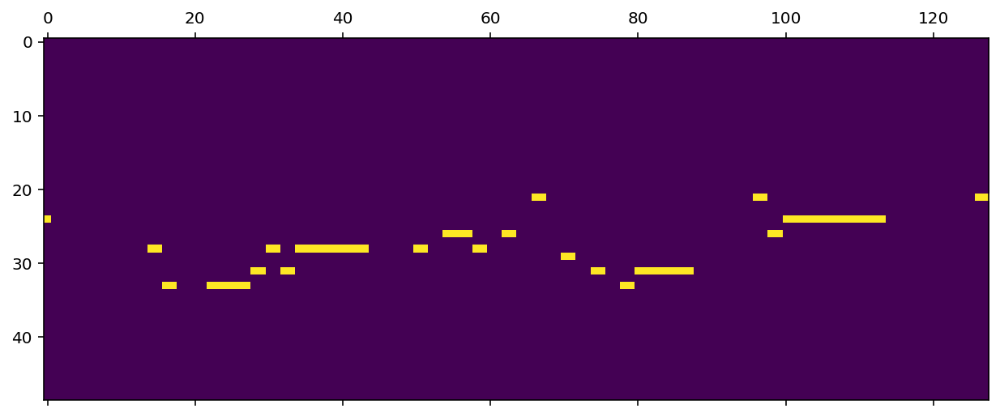

KeyboardInterrupt: ignored

In [ ]:
# original
import glob

# 最新の生成ファイルを指定（どれを選ぶかは自由。例：人間の耳で確認して良いものを指定する）
melody_filepaths = glob.glob(basedir + 'output/*.mid' ) # 全ての出力メロディのリストを取得
melody_filepaths.sort(reverse=True)
melody_filepath = melody_filepaths[0]
print(melody_filepath)
midi_data = pretty_midi.PrettyMIDI(melody_filepath)

after_care_and_show_and_play(midi_data)

[0]/content/drive/MyDrive/弁財天/magenta/output/2023-02-11_152613_10.mid


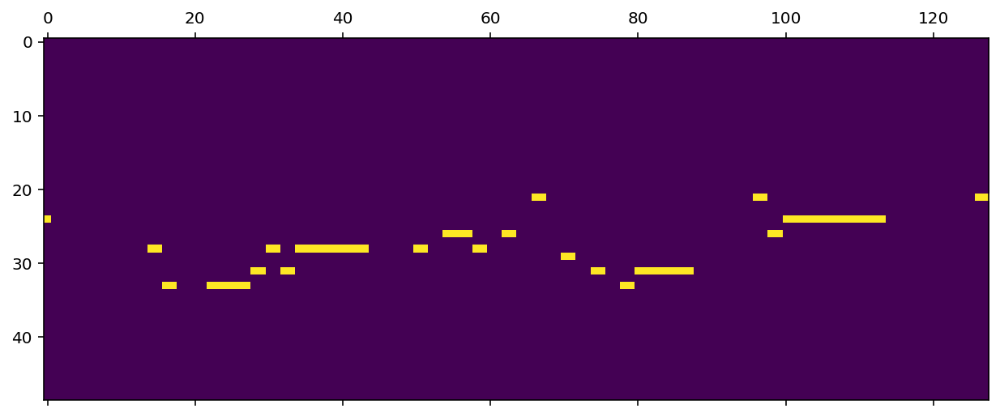

[1]/content/drive/MyDrive/弁財天/magenta/output/2023-02-11_152613_09.mid


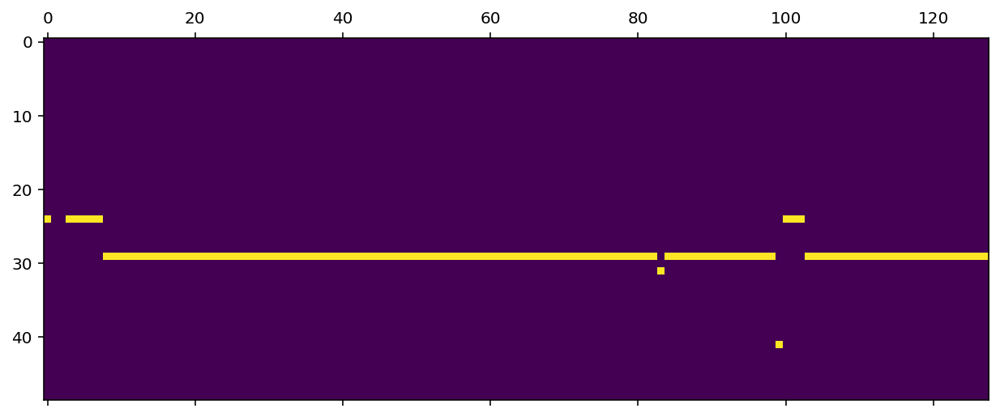

[2]/content/drive/MyDrive/弁財天/magenta/output/2023-02-11_152613_08.mid


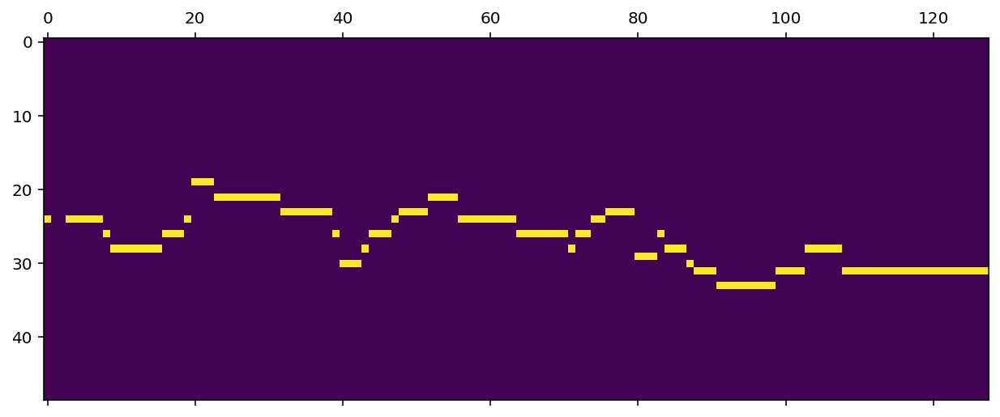

[3]/content/drive/MyDrive/弁財天/magenta/output/2023-02-11_152613_07.mid


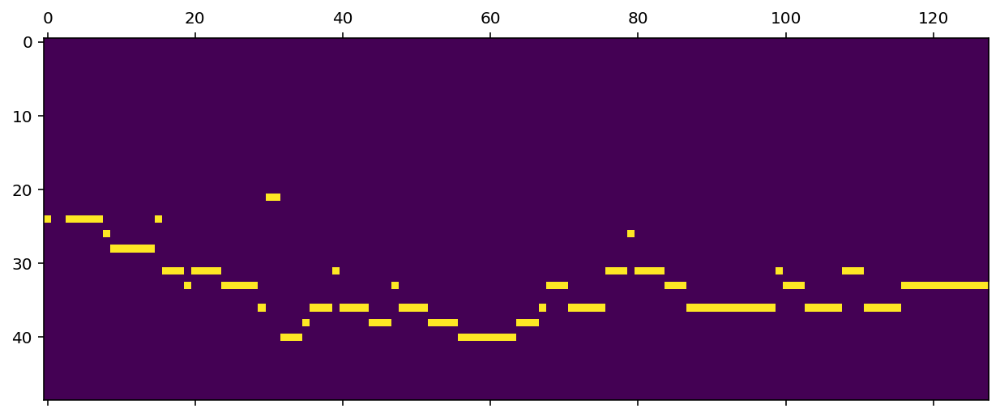

[4]/content/drive/MyDrive/弁財天/magenta/output/2023-02-11_152613_06.mid


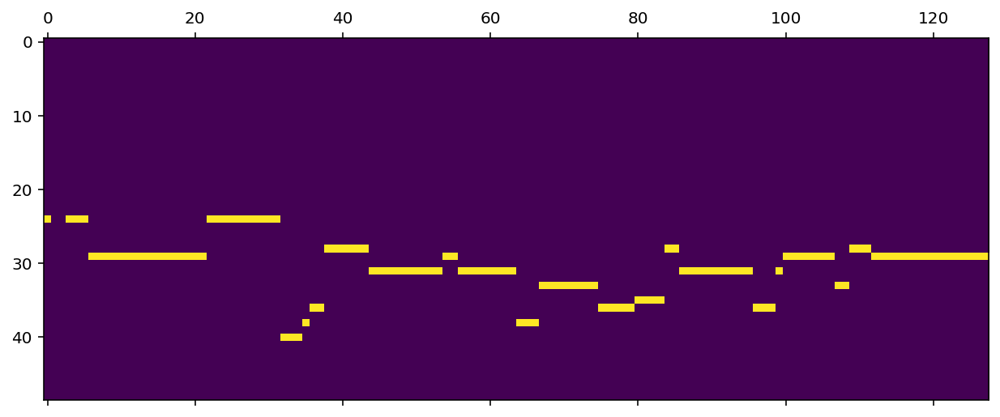

[5]/content/drive/MyDrive/弁財天/magenta/output/2023-02-11_152613_05.mid


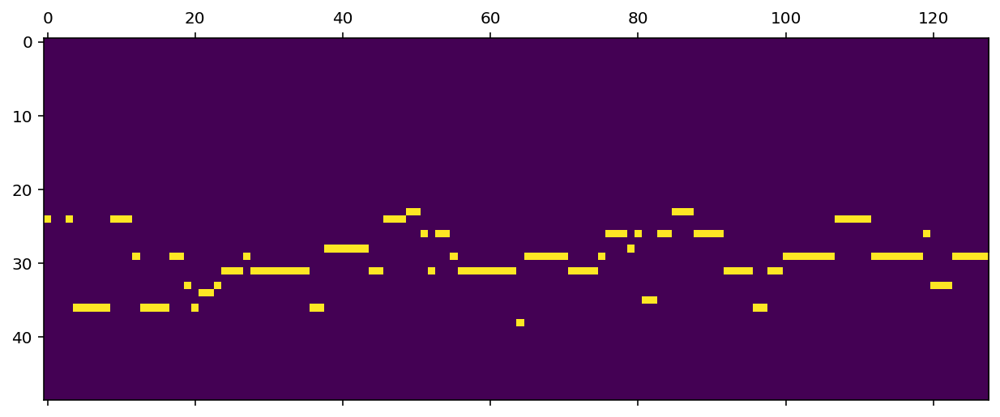

[6]/content/drive/MyDrive/弁財天/magenta/output/2023-02-11_152613_04.mid


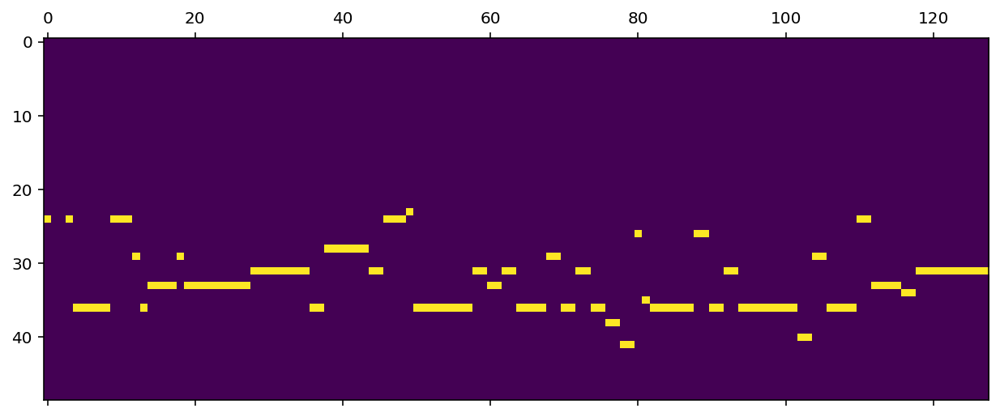

[7]/content/drive/MyDrive/弁財天/magenta/output/2023-02-11_152613_03.mid


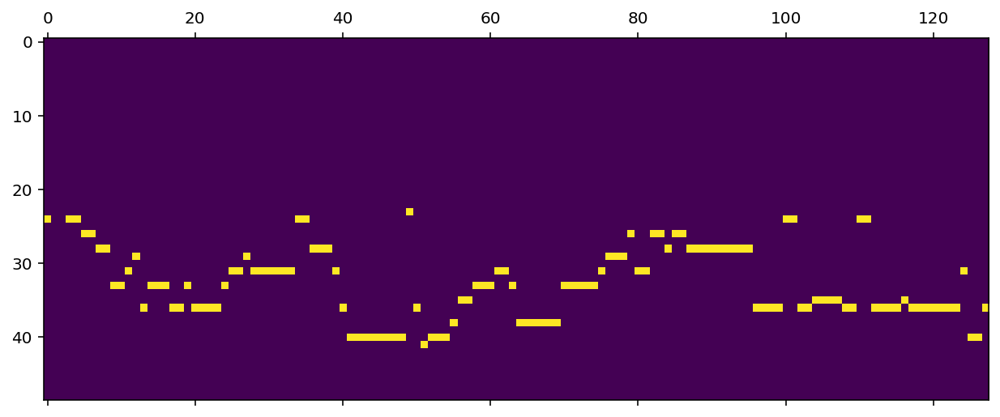

[8]/content/drive/MyDrive/弁財天/magenta/output/2023-02-11_152613_02.mid


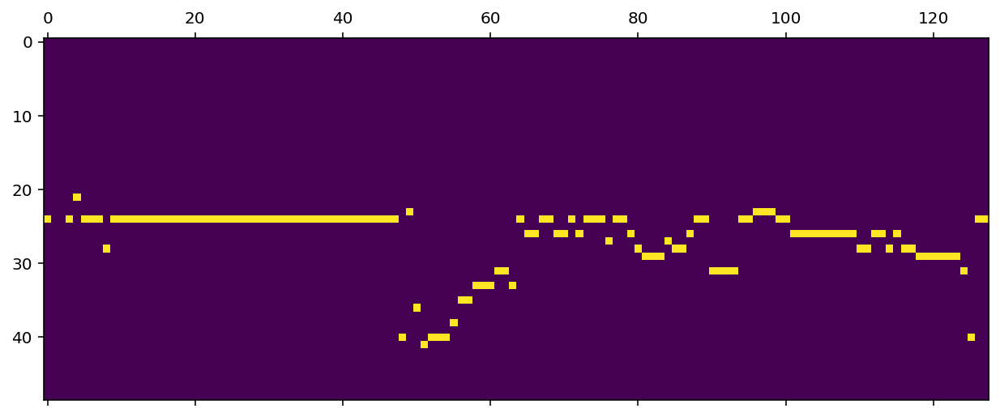

[9]/content/drive/MyDrive/弁財天/magenta/output/2023-02-11_152613_01.mid


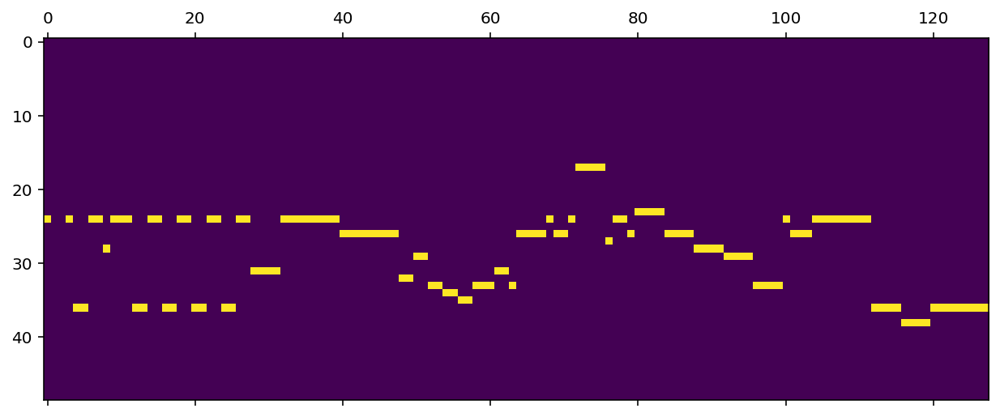

In [ ]:
# 作曲されたピアノロールの一覧表示
import glob

# 最新の生成ファイルを指定（どれを選ぶかは自由。例：人間の耳で確認して良いものを指定する）
melody_filepaths = glob.glob(basedir + 'output/*.mid' ) # 全ての出力メロディのリストを取得
melody_filepaths.sort(reverse=True)

for i in range(len(melody_filepaths)):
  melody_filepath = melody_filepaths[i]
  print("["+str(i)+"]"+melody_filepath)
  midi_data = pretty_midi.PrettyMIDI(melody_filepath)
  #処理なしで保存
  save(midi_data,)
  #後処理と保存
  after_care_and_show_and_play(midi_data,False)

name 


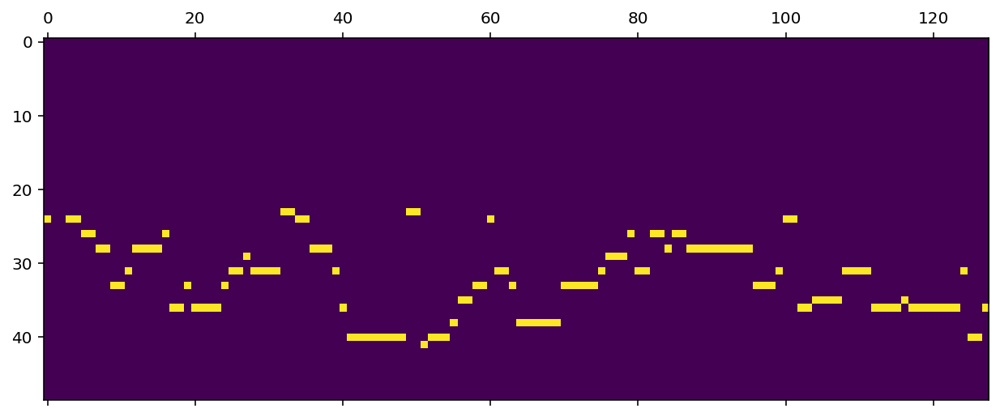

In [ ]:
# 聞きたい音源のindexを指定、指定されたファイルのピアロールと音源が提供される
melody_filepath = melody_filepaths[7]
midi_data = pretty_midi.PrettyMIDI(melody_filepath)
after_care_and_show_and_play_diatonik(midi_data)

In [ ]:
# TODO: 拡張のヒント